
### COVID-19 Exploratory Data Analysis (EDA)

#### Introduction
This notebook provides an in-depth analysis of COVID-19 cases, deaths, and vaccinations using two datasets:
- **COVID DEATHS** dataset: Contains case and death counts per country over time.
- **COVID VACCINATIONS** dataset: Includes vaccination data across countries.

#### Objectives:
1. **Explore missing values** with visual justifications.
2. **Clean the data** using appropriate methods
3. **Analyze trends in cases, deaths, and vaccinations.**
4. **Visualize global trends using interactive maps and plots.**
5. **Derive insights on factors like population density and healthcare impact.**


### Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from datetime import datetime                    # For statistical data visualization
import warnings
warnings.filterwarnings('ignore')

### Load the Dataset's

In [2]:
# Read CSV files into Pandas DataFrames
death = pd.read_csv("COVID DEATHS.csv")
vaccine = pd.read_csv("COVID_VACCINATIONS.csv")

### Exploring dataset

In [3]:
# Exploring the shape and information of the data
print(death.shape)
print(vaccine.shape)

(302749, 26)
(302749, 45)


In [4]:
print(death.info())
print(vaccine.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302749 entries, 0 to 302748
Data columns (total 26 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   iso_code                            302749 non-null  object 
 1   continent                           288347 non-null  object 
 2   location                            302749 non-null  object 
 3   date                                302749 non-null  object 
 4   population                          302749 non-null  int64  
 5   total_cases                         266771 non-null  float64
 6   new_cases                           294064 non-null  float64
 7   new_cases_smoothed                  292800 non-null  float64
 8   total_deaths                        246214 non-null  float64
 9   new_deaths                          294139 non-null  float64
 10  new_deaths_smoothed                 292909 non-null  float64
 11  total_cases_per_million   

In [5]:
## Display all rows and columns of a dataframe instead of a truncated version
from IPython.display import display
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [6]:
death.head()

,iso_code,continent,location,date,population,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million
0,AFG,Asia,Afghanistan,1/3/2020,41128772,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,1/4/2020,41128772,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,1/5/2020,41128772,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,1/6/2020,41128772,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,1/7/2020,41128772,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Observation: There are lots of missing values in the dataset

In [7]:

vaccine.head()

,iso_code,continent,location,date,total_tests,new_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,stringency_index,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,1/3/2020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54.42,18.6,2.58,1.34,1803.99,NaN,597.03,9.59,NaN,NaN,37.75,0.5,64.83,0.51,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,1/4/2020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54.42,18.6,2.58,1.34,1803.99,NaN,597.03,9.59,NaN,NaN,37.75,0.5,64.83,0.51,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,1/5/2020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54.42,18.6,2.58,1.34,1803.99,NaN,597.03,9.59,NaN,NaN,37.75,0.5,64.83,0.51,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,1/6/2020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54.42,18.6,2.58,1.34,1803.99,NaN,597.03,9.59,NaN,NaN,37.75,0.5,64.83,0.51,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,1/7/2020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54.42,18.6,2.58,1.34,1803.99,NaN,597.03,9.59,NaN,NaN,37.75,0.5,64.83,0.51,NaN,NaN,NaN,NaN


#### Observation: There are lots of missing values in the dataset

### Visualising Missing Data

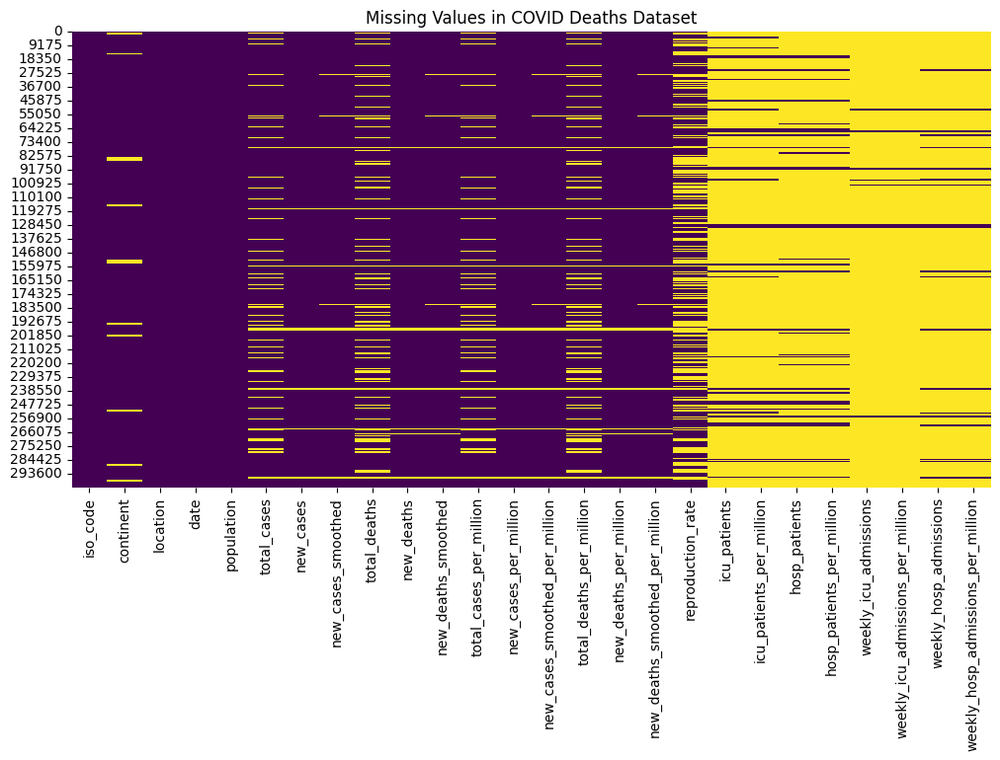

In [8]:
### Checking Missing Values
# Visualizing missing data
plt.figure(figsize=(12,6))
sns.heatmap(death.isnull(), cbar=False, cmap='viridis')
plt.title("Missing Values in COVID Deaths Dataset")
plt.show()


#### Observation: The yellow area signifies missing values we can see that a lot of columns have nearly 90%of missing values

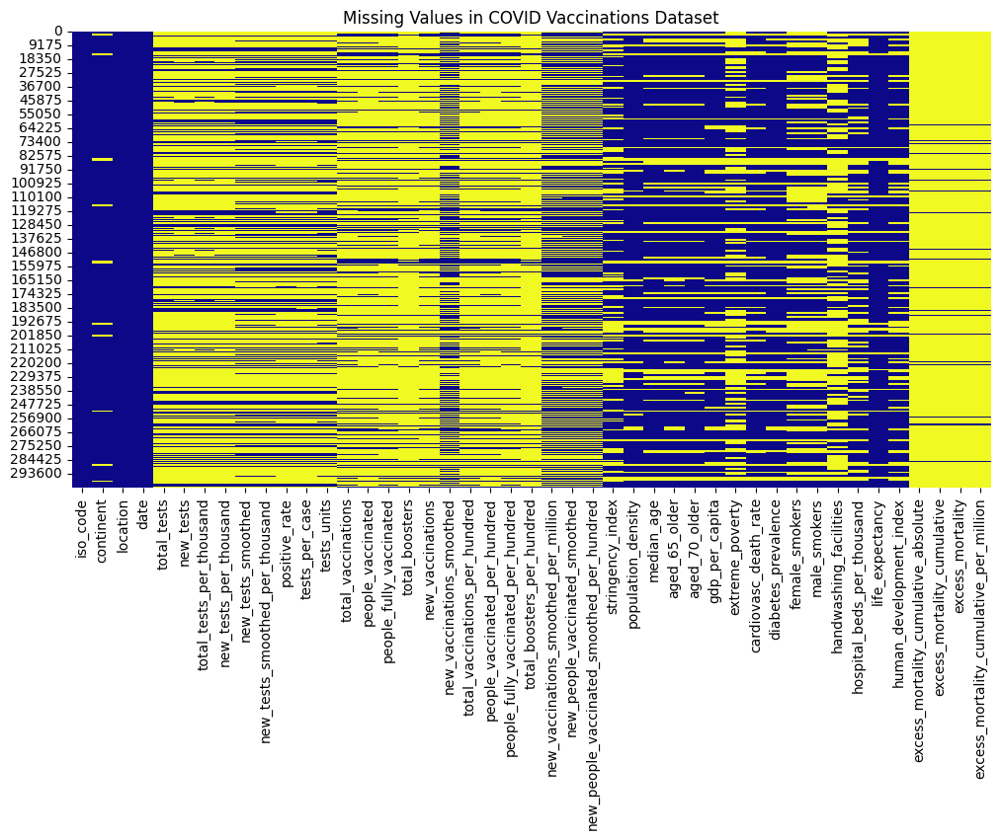

In [9]:

plt.figure(figsize=(12,6))
sns.heatmap(vaccine.isnull(), cbar=False, cmap='plasma')
plt.title("Missing Values in COVID Vaccinations Dataset")
plt.show()


In [10]:

# Percentage of missing values
missing_deaths = death.isnull().sum() / len(death) * 100
missing_vaccinations = vaccine.isnull().sum() / len(vaccine) * 100

# Show missing values above 10%
missing_deaths[missing_deaths > 10].sort_values(ascending=False), missing_vaccinations[missing_vaccinations > 10].sort_values(ascending=False)


(weekly_icu_admissions                 96.981328
 weekly_icu_admissions_per_million     96.981328
 weekly_hosp_admissions                92.942008
 weekly_hosp_admissions_per_million    92.942008
 icu_patients                          88.483529
 icu_patients_per_million              88.483529
 hosp_patients                         88.359334
 hosp_patients_per_million             88.359334
 reproduction_rate                     38.953721
 total_deaths                          18.673885
 total_deaths_per_million              18.673885
 total_cases                           11.883772
 total_cases_per_million               11.883772
 dtype: float64,
 excess_mortality_cumulative_per_million       96.599493
 excess_mortality                              96.599493
 excess_mortality_cumulative                   96.599493
 excess_mortality_cumulative_absolute          96.599493
 total_boosters_per_hundred                    85.967584
 total_boosters                                85.967584
 new

### COmbining datasets into one

In [11]:
# Merge death and vaccine DataFrames based on a common key
combined = pd.merge(death, vaccine, how='outer')

In [12]:
combined.isnull().sum()

,0
iso_code,0
continent,14402
location,0
date,0
population,0
total_cases,35978
new_cases,8685
new_cases_smoothed,9949
total_deaths,56535
new_deaths,8610


### Data Cleaning

In [13]:
# null %
null_perc=combined.isnull().sum()/len(combined)*100

In [14]:
null_perc.sort_values(ascending=False)

,0
weekly_icu_admissions_per_million,96.981328
weekly_icu_admissions,96.981328
excess_mortality_cumulative_per_million,96.599493
excess_mortality,96.599493
excess_mortality_cumulative,96.599493
excess_mortality_cumulative_absolute,96.599493
weekly_hosp_admissions_per_million,92.942008
weekly_hosp_admissions,92.942008
icu_patients_per_million,88.483529
icu_patients,88.483529


#### Dropping all columns who have >45% of missing data

In [15]:
# > 45% of missing data we'll drop
null_columns=combined.isnull().sum().sort_values(ascending=False)
null_columns

,0
weekly_icu_admissions_per_million,293610
weekly_icu_admissions,293610
excess_mortality_cumulative_per_million,292454
excess_mortality,292454
excess_mortality_cumulative,292454
excess_mortality_cumulative_absolute,292454
weekly_hosp_admissions_per_million,281381
weekly_hosp_admissions,281381
icu_patients_per_million,267883
icu_patients,267883


In [16]:
def remove_null_columns(data):
    perc=0.45
    df=data.copy()
    remove_cols=(df.isnull().sum()/len(df))
    remove_cols=list(remove_cols[remove_cols.values>=perc].index)
    df.drop(labels=remove_cols,axis=1,inplace=True)
    return df

In [17]:
combined1=remove_null_columns(combined)

In [18]:
# null %
null_perc_1=combined1.isnull().sum()/len(combined)*100

In [19]:
null_perc_1.sort_values(ascending=False)

,0
male_smokers,42.671322
female_smokers,41.880898
reproduction_rate,38.953721
stringency_index,36.186742
hospital_beds_per_thousand,31.611335
human_development_index,24.901816
aged_65_older,23.845826
gdp_per_capita,22.663328
cardiovasc_death_rate,22.526251
aged_70_older,21.874556


In [20]:
combined1.dropna(subset=['continent'], inplace=True)


In [21]:
combined1.shape

(288347, 31)

In [22]:
# Checking for duplicate rows
print(death[death.duplicated()])
print(vaccine[vaccine.duplicated()])

Empty DataFrame
Columns: [iso_code, continent, location, date, population, total_cases, new_cases, new_cases_smoothed, total_deaths, new_deaths, new_deaths_smoothed, total_cases_per_million, new_cases_per_million, new_cases_smoothed_per_million, total_deaths_per_million, new_deaths_per_million, new_deaths_smoothed_per_million, reproduction_rate, icu_patients, icu_patients_per_million, hosp_patients, hosp_patients_per_million, weekly_icu_admissions, weekly_icu_admissions_per_million, weekly_hosp_admissions, weekly_hosp_admissions_per_million]
Index: []
Empty DataFrame
Columns: [iso_code, continent, location, date, total_tests, new_tests, total_tests_per_thousand, new_tests_per_thousand, new_tests_smoothed, new_tests_smoothed_per_thousand, positive_rate, tests_per_case, tests_units, total_vaccinations, people_vaccinated, people_fully_vaccinated, total_boosters, new_vaccinations, new_vaccinations_smoothed, total_vaccinations_per_hundred, people_vaccinated_per_hundred, people_fully_vaccina

### Data Transformation

In [23]:
combined1.head()

,iso_code,continent,location,date,population,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,stringency_index,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,hospital_beds_per_thousand,life_expectancy,human_development_index
0,ABW,North America,Aruba,1/1/2021,106459,5442.0,69.0,30.571,49.0,0.0,0.286,51118.271,648.137,287.166,460.271,0.0,2.684,NaN,35.19,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
1,ABW,North America,Aruba,1/1/2022,106459,19719.0,698.0,364.857,181.0,0.0,0.000,185226.237,6556.515,3427.208,1700.185,0.0,0.000,NaN,34.26,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
2,ABW,North America,Aruba,1/1/2023,106459,43860.0,0.0,15.429,280.0,0.0,0.000,411989.592,0.000,144.925,2630.121,0.0,0.000,NaN,NaN,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
3,ABW,North America,Aruba,1/10/2020,106459,NaN,0.0,0.000,NaN,0.0,0.000,NaN,0.000,0.000,NaN,0.0,0.000,NaN,NaN,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
4,ABW,North America,Aruba,1/10/2021,106459,5883.0,0.0,63.000,50.0,0.0,0.143,55260.711,0.000,591.777,469.664,0.0,1.342,NaN,40.74,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN


In [24]:
combined1.head()

,iso_code,continent,location,date,population,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,stringency_index,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,hospital_beds_per_thousand,life_expectancy,human_development_index
0,ABW,North America,Aruba,1/1/2021,106459,5442.0,69.0,30.571,49.0,0.0,0.286,51118.271,648.137,287.166,460.271,0.0,2.684,NaN,35.19,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
1,ABW,North America,Aruba,1/1/2022,106459,19719.0,698.0,364.857,181.0,0.0,0.000,185226.237,6556.515,3427.208,1700.185,0.0,0.000,NaN,34.26,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
2,ABW,North America,Aruba,1/1/2023,106459,43860.0,0.0,15.429,280.0,0.0,0.000,411989.592,0.000,144.925,2630.121,0.0,0.000,NaN,NaN,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
3,ABW,North America,Aruba,1/10/2020,106459,NaN,0.0,0.000,NaN,0.0,0.000,NaN,0.000,0.000,NaN,0.0,0.000,NaN,NaN,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN
4,ABW,North America,Aruba,1/10/2021,106459,5883.0,0.0,63.000,50.0,0.0,0.143,55260.711,0.000,591.777,469.664,0.0,1.342,NaN,40.74,584.8,41.2,13.09,7.45,35973.78,NaN,11.62,NaN,NaN,NaN,76.29,NaN


In [25]:
combined1.columns

Index(['iso_code', 'continent', 'location', 'date', 'population',
       'total_cases', 'new_cases', 'new_cases_smoothed', 'total_deaths',
       'new_deaths', 'new_deaths_smoothed', 'total_cases_per_million',
       'new_cases_per_million', 'new_cases_smoothed_per_million',
       'total_deaths_per_million', 'new_deaths_per_million',
       'new_deaths_smoothed_per_million', 'reproduction_rate',
       'stringency_index', 'population_density', 'median_age', 'aged_65_older',
       'aged_70_older', 'gdp_per_capita', 'cardiovasc_death_rate',
       'diabetes_prevalence', 'female_smokers', 'male_smokers',
       'hospital_beds_per_thousand', 'life_expectancy',
       'human_development_index'],
      dtype='object')

### COlumns to keep

In [26]:
# List of columns to retain
columns_to_keep = [ 'continent', 'location', 'date', 'population',
                   'total_cases', 'new_cases', 'total_deaths', 'new_deaths',
                   'reproduction_rate', 'stringency_index', 'population_density',
                   'median_age', 'gdp_per_capita', 'diabetes_prevalence',
                   'hospital_beds_per_thousand', 'life_expectancy']

# Dropping redundant columns
combined1 = combined1[columns_to_keep]

In [27]:
# Calculate percentage of missing values
missing_percentage = (combined1.isnull().sum() / len(combined1)) * 100

# Display only columns with missing values
missing_percentage = missing_percentage[missing_percentage > 0].sort_values(ascending=False)

# Print missing values percentage
print("Percentage of Missing Values in Retained Columns:")
print(missing_percentage)


Percentage of Missing Values in Retained Columns:
reproduction_rate             36.277818
stringency_index              32.999476
hospital_beds_per_thousand    28.612054
total_deaths                  19.417230
gdp_per_capita                19.217124
median_age                    17.557665
diabetes_prevalence           14.927501
total_cases                   12.385771
population_density            11.333567
life_expectancy                3.869990
new_cases                      2.994656
new_deaths                     2.968645
dtype: float64


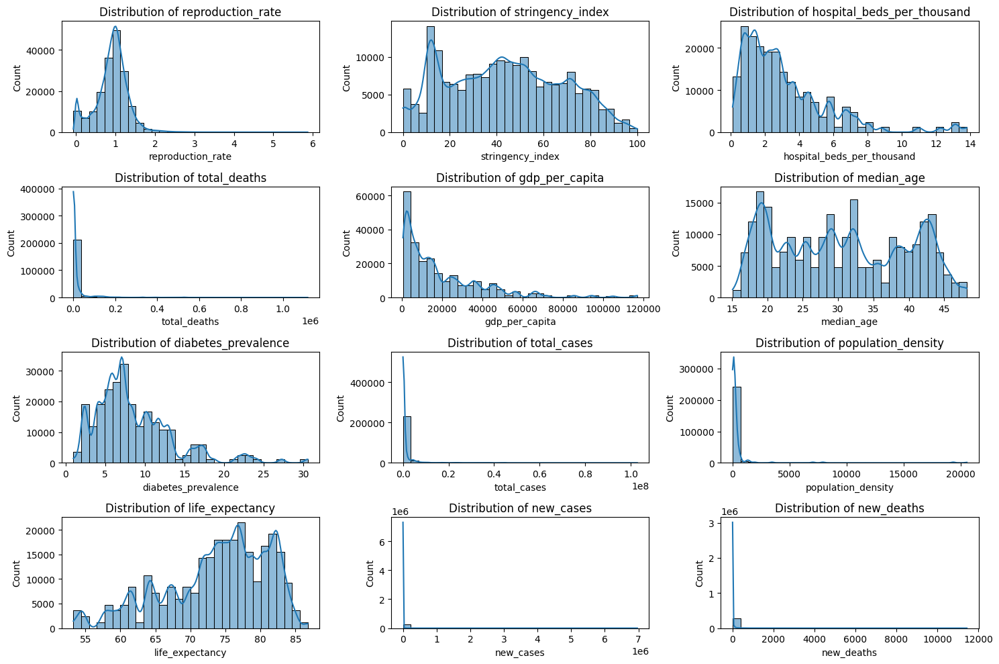

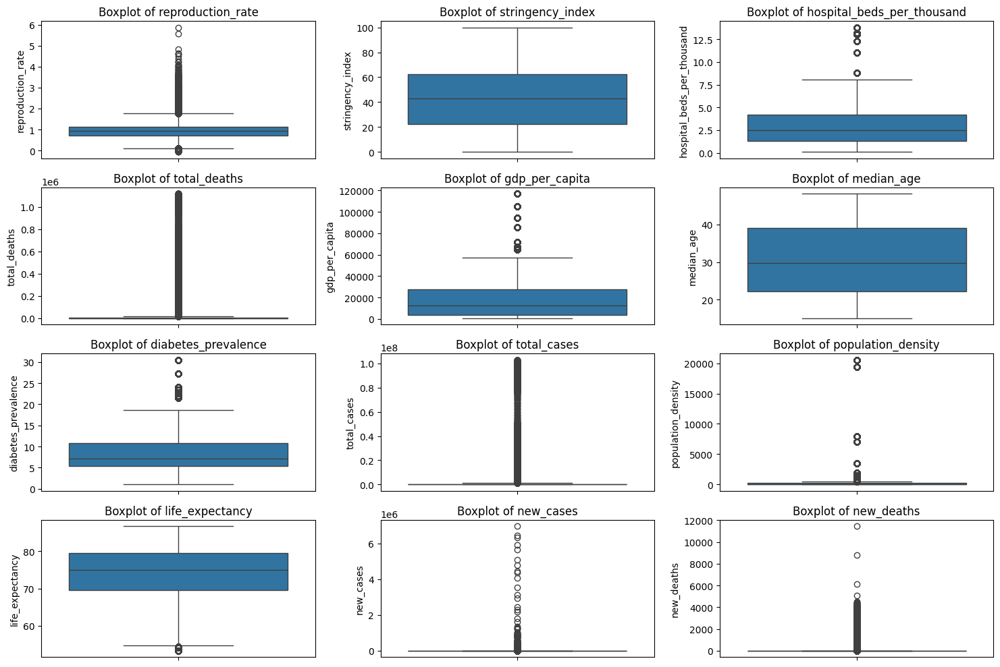

In [28]:
import matplotlib.pyplot as plt
import seaborn as sns

# List of columns with missing values
missing_cols = ['reproduction_rate', 'stringency_index', 'hospital_beds_per_thousand',
                'total_deaths', 'gdp_per_capita', 'median_age', 'diabetes_prevalence',
                'total_cases', 'population_density', 'life_expectancy', 'new_cases', 'new_deaths']

# Plot histograms
plt.figure(figsize=(15, 10))
for i, col in enumerate(missing_cols, 1):
    plt.subplot(4, 3, i)
    sns.histplot(combined1[col], bins=30, kde=True)
    plt.title(f'Distribution of {col}')
plt.tight_layout()
plt.show()

# Plot boxplots for skewed data detection
plt.figure(figsize=(15, 10))
for i, col in enumerate(missing_cols, 1):
    plt.subplot(4, 3, i)
    sns.boxplot(y=combined1[col])
    plt.title(f'Boxplot of {col}')
plt.tight_layout()
plt.show()


#### Observation:
From the visualizations, we observe the following characteristics for each feature:

1. **`reproduction_rate`**  
   - Slightly right-skewed but mostly **normally distributed**.
   - Can use **mean imputation**.

2. **`stringency_index`**  
   - Uniform-like distribution with peaks, meaning policies varied greatly across regions.
   - **Mean imputation** is suitable to maintain variability.

3. **`hospital_beds_per_thousand`**  
   - Right-skewed with a long tail (some countries have many hospital beds while others have very few).
   - **Median imputation** is preferred to handle extreme values.

4. **`total_deaths` & `total_cases`**  
   - Highly skewed, meaning a few countries contribute to extreme values.
   - **Forward Fill (`ffill`)** is best to maintain temporal consistency.

5. **`gdp_per_capita`**  
   - Strongly right-skewed with a heavy tail.
   - **Median imputation** is better to prevent extreme economic values from distorting results.

6. **`median_age`**  
   - Nearly uniform distribution across different ranges.
   - **Mean imputation** is appropriate.

7. **`diabetes_prevalence`**  
   - Bi-modal distribution with multiple peaks.
   - **Median imputation** is best since it’s skewed.

8. **`population_density`**  
   - Extremely right-skewed; some places (e.g., cities) have massive density while others have low values.
   - **Median imputation** to prevent urban centers from skewing results.

9. **`life_expectancy`**  
   - Normally distributed with a slight tail.
   - **Mean imputation** is appropriate.

10. **`new_cases` & `new_deaths`**  
    - Extreme right skew.
    - **Forward Fill (`ffill`)** is best to maintain trend integrity.

---

---

### **Summary of the Fixes**
| **Column**                     | **Imputation Strategy**  | **Reasoning** |
|---------------------------------|-------------------------|--------------|
| `reproduction_rate`             | Mean                    | Normal distribution |
| `stringency_index`              | Mean                    | Policy data, varies evenly |
| `hospital_beds_per_thousand`    | Median                  | Right-skewed with extreme values |
| `total_deaths`, `total_cases`   | Forward Fill (`ffill`)  | Time-series data must remain consistent |
| `gdp_per_capita`                | Median                  | Strongly skewed distribution |
| `median_age`                    | Mean                    | Even distribution across values |
| `diabetes_prevalence`           | Median                  | Bi-modal with varying regions |
| `population_density`            | Median                  | Prevents outliers from affecting results |
| `life_expectancy`               | Mean                    | Normally distributed |
| `new_cases`, `new_deaths`       | Forward Fill (`ffill`)  | Ensures trends stay realistic |



In [29]:
# Handling missing values based on distribution

# 1️⃣ Mean Imputation for Normally Distributed Features
mean_impute_cols = ['reproduction_rate', 'stringency_index', 'median_age', 'life_expectancy']
combined1[mean_impute_cols] = combined1[mean_impute_cols].fillna(combined1[mean_impute_cols].mean())

# 2️⃣ Median Imputation for Skewed Features
median_impute_cols = ['hospital_beds_per_thousand', 'gdp_per_capita', 'diabetes_prevalence', 'population_density']
combined1[median_impute_cols] = combined1[median_impute_cols].fillna(combined1[median_impute_cols].median())

# 3️⃣ Forward Fill for Time-Series Features
time_series_fill_cols = ['total_cases', 'total_deaths', 'new_cases', 'new_deaths']
combined1[time_series_fill_cols] = combined1[time_series_fill_cols].fillna(method='ffill').fillna(method='bfill')

# Verify that missing values are handled
print("Remaining Missing Values After Imputation:")
print(combined1.isnull().sum()[combined1.isnull().sum() > 0])


Remaining Missing Values After Imputation:
Series([], dtype: int64)


In [30]:
combined1.isnull().sum()

,0
continent,0
location,0
date,0
population,0
total_cases,0
new_cases,0
total_deaths,0
new_deaths,0
reproduction_rate,0
stringency_index,0


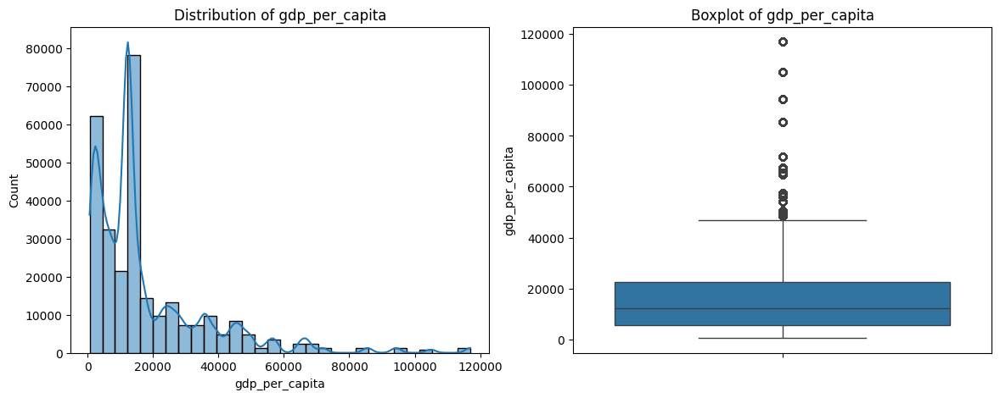

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns

def univariate_analysis(df, column):
    """
    Generate histogram & boxplot for a given column.
    """
    plt.figure(figsize=(14, 5))

    # Histogram & KDE plot
    plt.subplot(1, 2, 1)
    sns.histplot(df[column], bins=30, kde=True)
    plt.title(f"Distribution of {column}")

    # Boxplot
    plt.subplot(1, 2, 2)
    sns.boxplot(y=df[column])
    plt.title(f"Boxplot of {column}")

    plt.show()

# Example: Run this function for each column separately
column_name = 'gdp_per_capita'  # Change column name for each analysis
univariate_analysis(combined1, column_name)


### Visualizing the data

In [32]:
import pandas as pd
import plotly.express as px

def plot_yearly_univariate(df, column, title):
    """
    Function to generate a line plot for a single column over the years.

    Parameters:
    df (DataFrame): The dataset containing COVID-19 data
    column (str): Column to plot
    title (str): Title of the plot
    """
    # Convert date to datetime format and extract year
    df['date'] = pd.to_datetime(df['date'])
    df['year'] = df['date'].dt.year

    # Group data by year and sum the selected column
    yearly_data = df.groupby('year')[column].sum().reset_index()

    # Create a line plot for a single column
    fig = px.line(yearly_data, x='year', y=column,
                  markers=True, title=title, template="plotly_dark")

    fig.update_layout(yaxis_title="Count", xaxis_title="Year")
    fig.show()

# Call function separately for each metric
plot_yearly_univariate(combined1, 'total_cases', "Yearly Trend of Total Cases")


Insights from Yearly Trend of Total Cases Graph
Sharp Increase from 2020 to 2022:

The total number of COVID-19 cases grew exponentially from 2020 to 2022.
This aligns with major pandemic waves and new variants (Delta, Omicron).
Peak in 2022:

2022 had the highest total cases, likely due to the highly contagious Omicron variant.
Increased testing capacity and widespread infections contributed to this surge.
Decline in 2023:

A significant drop in 2023 suggests improved immunity (vaccination & prior infections).
Possible factors: lower transmission, relaxed testing, and milder variants.
Flattening in Early Years (2020-2021):

The slow rise in 2020 & 2021 reflects initial outbreak stages, lockdowns, and restrictions limiting spread.
Next Steps for Deeper Insights:
✅ Compare with vaccination data – Did vaccines contribute to the decline?
✅ Analyze country-wise trends – Did some regions have delayed outbreaks?




In [33]:
plot_yearly_univariate(combined1, 'new_cases', "Yearly Trend of New Cases")


In [34]:
plot_yearly_univariate(combined1, 'total_deaths', "Yearly Trend of Total Deaths")


In [35]:
plot_yearly_univariate(combined1, 'new_deaths', "Yearly Trend of New Deaths")


### Visualizing the Trend of `Cases` throughout months of different Years

In [36]:
import pandas as pd
import plotly.express as px

def plot_monthly_trend(df, column, title):
    """
    Function to generate a line plot for a given column, showing monthly trends across different years.

    Parameters:
    df (DataFrame): The dataset containing COVID-19 data
    column (str): Column to analyze (e.g., 'new_cases', 'new_deaths')
    title (str): Title of the plot
    """
    # Convert date to datetime format
    df['date'] = pd.to_datetime(df['date'])

    # Extract year and month
    df['year'] = df['date'].dt.year
    df['month'] = df['date'].dt.month

    # Group data by year and month, summing the column
    monthly_data = df.groupby(['year', 'month'])[column].sum().reset_index()

    # Convert month number to month name for better readability
    monthly_data['month'] = monthly_data['month'].apply(lambda x: pd.to_datetime(str(x), format='%m').strftime('%b'))

    # Create a line plot using Plotly
    fig = px.line(monthly_data, x='month', y=column, color='year',
                  markers=True, title=title, template="plotly_dark",
                  labels={'month': 'Month', column: 'Count'})

    fig.update_layout(yaxis_title="Count", xaxis_title="Month", legend_title="Year")
    fig.show()

# Call function for different metrics
plot_monthly_trend(combined1, 'new_cases', "Monthly Trend of New Cases Across Different Years")


### **Insights from the Monthly Trend of New Cases Across Different Years**  

1. **2022 Had the Highest Peak in January & December**  
   - The **Omicron variant** drove a massive spike in **January 2022**, making it the highest recorded month for new cases.  
   - Another **huge surge in December 2022** suggests a potential **new wave**, possibly due to **holiday travel & indoor gatherings**.

2. **2021 Shows Mid-Year Surges**  
   - Unlike 2022, **2021 had multiple smaller peaks**, especially in **March, May, and July**.  
   - This aligns with the **Delta variant wave** and varying **lockdown restrictions**.

3. **2020 Had an Initial Growth, Then Stabilized**  
   - A slow increase in **early months (March-May 2020)** reflects the **initial global outbreak**.  
   - Cases stabilized by the end of the year, likely due to **lockdowns and early prevention measures**.

4. **2023 Shows Lower Case Counts Overall**  
   - The line for **2023 remains significantly lower** throughout the months.  
   - This suggests **improved immunity** due to **vaccinations, prior infections, and weaker virus strains**.

5. **Seasonal Impact on Case Surges**  
   - **Winter months (Jan, Dec) have the highest peaks**, indicating that **cold weather & holiday gatherings** increase transmission.  
   - **Summer months (June-Aug) show lower cases**, possibly due to outdoor activities reducing spread.

---




### Visualization of Top 10 Countries by COVID-19 Cases Over Years

In [37]:
combined1.columns

Index(['continent', 'location', 'date', 'population', 'total_cases',
       'new_cases', 'total_deaths', 'new_deaths', 'reproduction_rate',
       'stringency_index', 'population_density', 'median_age',
       'gdp_per_capita', 'diabetes_prevalence', 'hospital_beds_per_thousand',
       'life_expectancy', 'year', 'month'],
      dtype='object')

In [38]:
import pandas as pd
import plotly.express as px

def plot_top_countries_cases(df, year):
    """
    Function to visualize the Top 10 countries by total COVID-19 cases for a given year.

    Parameters:
    df (DataFrame): The dataset containing COVID-19 data
    year (int): The year for which to plot the top 10 countries
    """
    # Filter data for the selected year
    df_year = df[df['year'] == year]

    # Group by country (location) and sum total cases
    country_cases = df_year.groupby('location')['total_cases'].max().reset_index()

    # Select the top 10 countries with the highest cases
    top_countries = country_cases.nlargest(10, 'total_cases')

    # Create a bar chart using Plotly
    fig = px.bar(top_countries, x='location', y='total_cases',
                 text='total_cases', title=f"Top 10 Countries by COVID-19 Cases in {year}",
                 labels={'total_cases': 'Total Cases', 'location': 'Country'},
                 template="plotly_dark", color='total_cases')

    fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
    fig.update_layout(xaxis_title="Country", yaxis_title="Total Cases")
    fig.show()

# Example: Plot for different years
plot_top_countries_cases(combined1, 2020)



In [39]:
plot_top_countries_cases(combined1, 2021)


In [40]:
plot_top_countries_cases(combined1, 2022)


In [41]:
plot_top_countries_cases(combined1, 2023)

### Realtionship between GDP and cases

In [42]:
def plot_gdp_vs_cases(df):
    fig = px.scatter(df, x='gdp_per_capita', y='total_cases', color='continent',
                     size='population', title="GDP per Capita vs Total Cases",
                     hover_name='location', log_x=True, template="plotly_dark")
    fig.show()

plot_gdp_vs_cases(combined1)


#### **Insights from GDP per Capita vs Total Cases Graph**  

- **Higher GDP countries (right side) tend to report more cases**, likely due to **better testing and healthcare infrastructure**.  
- **Middle-income countries (GDP ~10k) have the highest case clusters**, particularly in **Asia (red) and Europe (purple)**.  
- **Low-GDP countries (left side) have fewer reported cases**, possibly due to **limited testing, underreporting, or lower urban density**.  
- **North America (blue) shows large case numbers even in high-GDP nations**, reflecting widespread testing and large urban populations.  
- **South America (red) has high cases concentrated in the 5k-15k GDP range**, indicating significant outbreaks in middle-income economies.  



 ### Impact of Population Density on COVID-19 Spread

In [43]:
def plot_population_density_vs_cases(df):
    fig = px.scatter(df, x='population_density', y='total_cases', color='continent',
                     title="Population Density vs Total Cases",
                     hover_name='location', log_x=True, template="plotly_dark")
    fig.show()

plot_population_density_vs_cases(combined1)

# Hypothesis: Densely populated areas may have higher COVID-19 cases.

### **Insights from Population Density vs Total Cases Graph**  

- **Countries with moderate population density (50-500 people per km²) show the highest case numbers**, especially in **North America, Asia, and Europe**.  
- **High-density regions (>1000 people per km²) do not always have the most cases**, suggesting **other factors like testing availability and healthcare response play a role**.  
- **North America (blue) and Asia (red) have the highest concentration of cases**, indicating that urbanized regions experienced significant outbreaks.  
- **South America (orange) and Europe (purple) have clusters in mid-to-high population density areas**, suggesting a strong link between urbanization and transmission rates.  
- **Low-density regions (left side) report fewer cases**, possibly due to **rural areas having lower transmission rates or limited testing capacity**.  



### Correlation Between Stringency Index & Cases Over Time


In [44]:
def plot_stringency_vs_cases(df):
    fig = px.scatter(df, x='stringency_index', y='new_cases', color='continent',
                     title="Stringency Index vs New Cases",
                     hover_name='location', template="plotly_dark")
    fig.show()

plot_stringency_vs_cases(combined1)


### **Insights from Stringency Index vs New Cases Graph**  

- **Most new cases are clustered at a stringency index of 40-60**, indicating that **moderate lockdown measures were in place during high transmission periods**.  
- **Some high new case spikes occur even at lower stringency values (~30-40)**, suggesting **lockdown measures may have been implemented late in some regions**.  
- **Higher stringency levels (above 80) show fewer cases**, implying that **strict lockdowns were effective in reducing transmission**.  
- **Asia (red) and North America (blue) have the highest spikes in new cases**, showing that even with lockdowns, these regions faced major outbreaks.  
- **Europe (purple) and South America (orange) have a more distributed pattern**, indicating **varying policy effectiveness across countries**.  



# Treemap – Total Cases by Continent & Country
🔍 Hypothesis: Visualize which countries had the most cases within each continent.


In [45]:
def plot_treemap_cases(df):
    fig = px.treemap(df, path=['continent', 'location'], values='total_cases',
                     title="Treemap of COVID-19 Cases by Continent & Country",
                     color='total_cases', template="plotly_dark")
    fig.show()

plot_treemap_cases(combined1)


### **Insights from Treemap of COVID-19 Cases by Continent & Country**  

- **North America, Asia, and Europe dominate the total cases** globally, with **the United States, India, and Brazil** being the largest contributors.  
- **The United States has the largest share of total cases**, reflecting high testing rates and widespread outbreaks.  
- **India and Brazil have significantly large case counts in Asia and South America, respectively**, suggesting major outbreaks in highly populated regions.  
- **In Europe, France, Germany, the UK, and Russia have major case counts**, highlighting severe outbreaks across the continent.  
- **China, despite being the origin of the virus, has a relatively smaller case count**, possibly due to strict lockdowns and controlled spread.  
- **Africa and Oceania have the smallest case share**, indicating either lower transmission rates or underreporting due to limited testing.  



## Bar Chart – Top 10 Countries by Total Deaths
🔍 Hypothesis: Identify which countries had the highest death tolls

In [46]:
def plot_top_10_countries_deaths(df):
    top_countries = df.groupby('location')['total_deaths'].max().reset_index()
    top_countries = top_countries.nlargest(10, 'total_deaths')

    fig = px.bar(top_countries, x='location', y='total_deaths', color='total_deaths',
                 title="Top 10 Countries by COVID-19 Deaths", template="plotly_dark")
    fig.show()

plot_top_10_countries_deaths(combined1)


 ###  Hospital Beds per Thousand vs Death Rate
🔍 Hypothesis: Countries with more hospital beds per capita may have lower fatality rates.

In [47]:
def plot_hospital_beds_vs_deaths(df):
    fig = px.scatter(df, x='hospital_beds_per_thousand', y='total_deaths',
                     color='continent', title="Hospital Beds per Thousand vs Deaths",
                     hover_name='location', template="plotly_dark")
    fig.show()

plot_hospital_beds_vs_deaths(combined1)


### **Insights from Hospital Beds per Thousand vs Deaths Graph**  

- **Countries with fewer hospital beds per thousand (<2) have the highest deaths**, indicating that **lack of healthcare infrastructure contributed to higher fatality rates**.  
- **North America (blue) and South America (orange) show high deaths even at lower hospital bed availability**, suggesting that **hospital overcrowding was a major issue during peak waves**.  
- **Europe (purple) has a more distributed trend**, with some countries having higher hospital beds but still recording significant deaths.  
- **Countries with >5 hospital beds per thousand show lower deaths**, indicating **better-equipped healthcare systems were able to handle severe cases more effectively**.  
- **Some high-death regions had relatively high hospital bed availability**, which could be due to **delayed responses, overwhelmed hospitals, or differences in healthcare quality**.  

